# Library

In [203]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib
import folium
from folium.plugins import HeatMap
import plotly.graph_objects as go
import branca.colormap as cm

from scipy.stats import boxcox
from sklearn.preprocessing import StandardScaler, RobustScaler, MinMaxScaler, Normalizer

from dotenv import load_dotenv
import sqlalchemy as db
import os
from geopy.geocoders import Nominatim, Photon, DataBC
from geopy.extra.rate_limiter import RateLimiter
from tqdm.notebook import tqdm_notebook
from functools import partial

In [2]:
load_dotenv()

True

In [3]:
tqdm_notebook.pandas()

c:\users\zylveyn\appdata\local\programs\python\python39\lib\site-packages\tqdm\std.py:702: FutureWarning: The Panel class is removed from pandas. Accessing it from the top-level namespace will also be removed in the next version
  from pandas import Panel


In [4]:
pd.set_option('display.max_columns', 500)
pd.set_option('display.float_format', lambda x: '%.6f' % x)

# Load Dataset

In [5]:
engine = db.create_engine(os.getenv('db-uri'))
conn = engine.connect()

OperationalError: (psycopg2.OperationalError) FATAL:  role "cmlbsrhxuewffs" is not permitted to log in

(Background on this error at: http://sqlalche.me/e/13/e3q8)

In [ ]:
meta = db.MetaData()
meta.reflect(engine)

In [ ]:
tables = dict()
for table in meta.tables:
    tables[table] = meta.tables[table]

In [ ]:
query = db.select([tables['Restaurants']])
result = conn.execute(query).fetchall()

In [ ]:
df = pd.DataFrame(result, columns=tables['Restaurants'].c.keys()).drop('index', axis=1)
df.head()

In [5]:
df = pd.read_csv('Datasets/data_full.csv', index_col=0)
df.head()

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869","Bawa Pulang Tersedia, Alkohol Tersedia, Reserv...","-6.2162290000,106.7978830000"
1,Restoran Kasual,Furusato Izakaya,https://www.zomato.com/id/jakarta/furusato-iza...,4.300000,152.000000,Sudirman,"Jl. Jend Sudirman No. 36, Sudirman, Jakarta 10210",Jepang,500000.000000,"11h 30m - 14h 30m, 18h - 21h (Sen-Jum),11h - 1...",NaN,+628119250020,"Hanya Wine dan Bir, Parkir Valet Tersedia, Are...","-6.2146764771,106.8168163228"
2,Restoran Kasual,Animale Restaurant,https://www.zomato.com/id/jakarta/animale-rest...,4.300000,125.000000,Setiabudi,"MD Place Bulding, Lantai 11, Jl. Setiabudi Sel...","Amerika, Mediterania",500000.000000,"12h - 14h 30m, 17h 30m - 22h (Sen-Sab),12h 30m...",NaN,"+622129669260, +6287772646253","Bawa Pulang Tersedia, Hanya Bir, Reservasi mej...","-6.2086409900,106.8284083530"
3,Restoran Kasual,Wolfgang's Steakhouse,https://www.zomato.com/id/jakarta/wolfgangs-st...,3.400000,54.000000,SCBD,"Elysee Building, Level 6 Rooftop, LOT 21 SCBD\...",Steak,500000.000000,11h 30m - 22h (Sen-Min),NaN,+6262811150955,"Bawa Pulang Tersedia, Tempat duduk di luar, Re...","-6.2257438285,106.8130087852"
4,Restoran Kasual,Medja Restaurant,https://www.zomato.com/id/jakarta/medja-restau...,4.000000,277.000000,Bogor Timur,"Jl. Pajajaran Indah V No. 6, Bogor Timur, Bogor",Indonesia,360000.000000,"11h - 21h (Sen-Jum),10h - 21h (Sab-Min)",NaN,+622518385841,"Bawa Pulang Tersedia, Hanya Bir, Tempat duduk ...","-6.6096150000,106.8123640000"


# Duplicate Values

In [6]:
df.drop_duplicates('res_link', inplace=True)

# EDA

## Restaurant Category

### Which Category Has The Most Restaurants?

In [7]:
df['category'].value_counts()

Quick Bites                      5805
Restoran Kasual                  2000
Pujasera                         1590
Kafe                             1555
Toko Minuman                     1113
                                 ... 
Pujasera, Kios Jus                  1
Kaki Lima, Kios                     1
Pujasera, Beer Garden               1
Toko Dessert, Kios                  1
Restoran Kasual, Bar Cocktail       1
Name: category, Length: 76, dtype: int64

In [8]:
df['category'].isna().sum()

4

In [9]:
res_cat = df['category'].str.split(', ', expand=True)
res_cat = pd.concat([res_cat[0], res_cat[1]])
res_cat = res_cat.replace(np.nan, 'No Category')
res_cat

0        Restoran Kasual
1        Restoran Kasual
2        Restoran Kasual
3        Restoran Kasual
4        Restoran Kasual
              ...       
15030        No Category
15032        No Category
15033        No Category
15035        No Category
15036        No Category
Length: 27940, dtype: object

In [10]:
res_cat.value_counts().index

Index(['No Category', 'Quick Bites', 'Restoran Kasual', 'Kafe', 'Pujasera',
       'Toko Minuman', 'Toko Kue & Roti', 'Toko Dessert', 'Kaki Lima', 'Kios',
       'Bar', 'Lounge', 'Restoran Fine Dining', 'Klub', 'Kios Jus', 'Pub',
       'Bar Wine', 'Beer Garden', 'Bar Cocktail'],
      dtype='object')

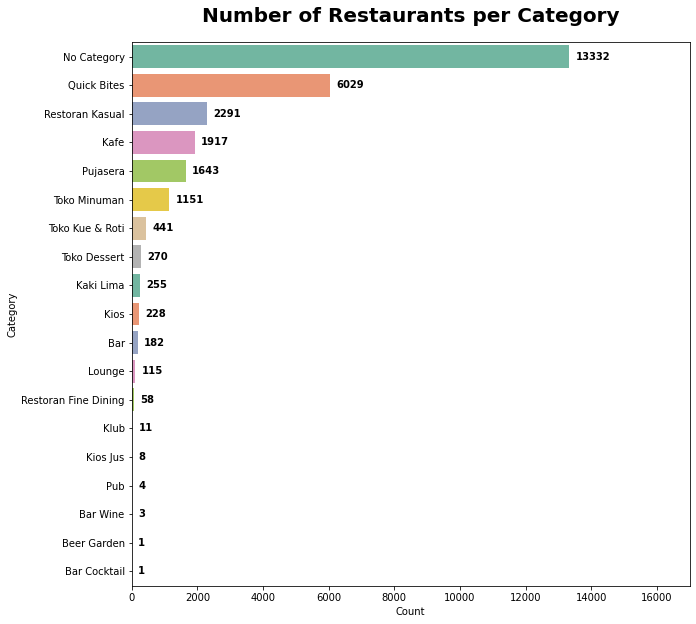

In [11]:
fig, ax = plt.subplots(figsize=(10, 10))
g = sns.countplot(y=res_cat, order=res_cat.value_counts().index, palette='Set2', ax=ax)

for patch in g.patches:
    g.text(s=patch.get_width(), x=patch.get_width()+200, y=patch.get_y()+patch.get_height()/2, 
           va='center', fontdict=dict(weight='bold'))

g.set_xlim([0, 17000])
ax.set_title('Number of Restaurants per Category', size=20, pad=20, fontweight='bold')
ax.set_ylabel('Category')
ax.set_xlabel('Count')
plt.show()

## Price For Two

### How is the price distribution?

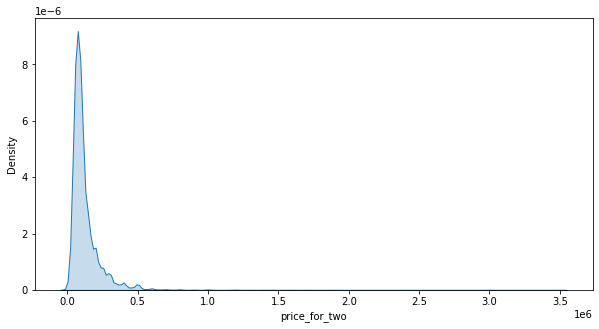

In [12]:
fig, ax = plt.subplots(figsize=(10, 5))
g = sns.kdeplot(df.price_for_two, ax=ax, fill=True)

### How is the percentiles of the price?

In [13]:
percents = np.arange(10, 101, 10)
percentile = np.nanpercentile(np.array(df.price_for_two), percents)
percentile_df = pd.DataFrame(percentile, index=percents)
percentile_df.columns = ['Price For Two']
percentile_df = percentile_df.append(pd.DataFrame([np.mean(df.price_for_two)], index=['Mean'], columns=['Price For Two']))
percentile_df

,Price For Two
10,50000.000000
20,60000.000000
30,70000.000000
40,80000.000000
50,90000.000000
60,100000.000000
70,120000.000000
80,150000.000000
90,250000.000000
100,3500000.000000


### Which restaurant is the most expensive?

In [14]:
df[df.price_for_two == df.price_for_two.max()]

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
3836,Restoran Fine Dining,Tatemukai,https://www.zomato.com/id/jakarta/tatemukai-th...,4.300000,179.000000,"Grand Indonesia Mall, Thamrin","Grand Indonesia Mall, Lantai 3A, Sky Bridge, J...","Jepang, Sushi",3500000.000000,"11h 30m - 15h, 18h 30m - 22h (Sen-Min)",NaN,+622123581807,"Bawa Pulang Tersedia, Hanya Wine dan Bir, Di d...","-6.1952190000,106.8209960000"


### Which restaurant is the cheapest?

In [15]:
df[df.price_for_two == df.price_for_two.min()]

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
10752,Quick Bites,Chikidot,https://www.zomato.com/id/jakarta/chikidot-tam...,nan,nan,Tambora,"Jl. Krendang Tengah, 48, RW 3, Krendang, Kec, ...",Indonesia,40.000000,7h - 22h (Sen-Min),NaN,+628111088796,"Bawa Pulang Tersedia, Di dalam ruangan","-6.1494550000,106.8038290000"


## Cuisines

### Which type of cuisine has the most restaurant?

In [16]:
list_cuisines = df.cuisines.str.split(', ').explode()
list_cuisines.value_counts()

Indonesia    3770
Kopi         2675
Barat        1128
Chinese      1103
Jawa         1062
             ... 
Peruvian        1
Yunani          1
Deli            1
Maroko          1
Portugal        1
Name: cuisines, Length: 87, dtype: int64

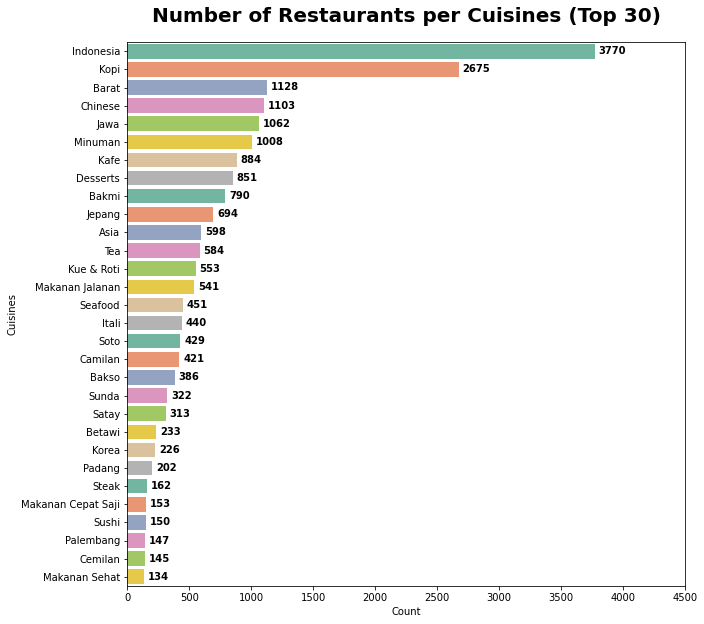

In [17]:
top30 = list_cuisines.value_counts().to_frame()[:30]

fig, ax = plt.subplots(figsize=(10, 10))
g = sns.barplot(data=top30.reset_index(), y='index', x='cuisines', palette='Set2', ax=ax)

for patch in g.patches:
    g.text(s=f'{patch.get_width():.0f}', x=patch.get_width()+30, y=patch.get_y()+patch.get_height()/2, 
           va='center', fontdict=dict(weight='bold'))

ax.set_xlim(0, 4500)
ax.set_title('Number of Restaurants per Cuisines (Top 30)', size=20, pad=20, fontweight='bold')
ax.set_ylabel('Cuisines')
ax.set_xlabel('Count')
plt.show()

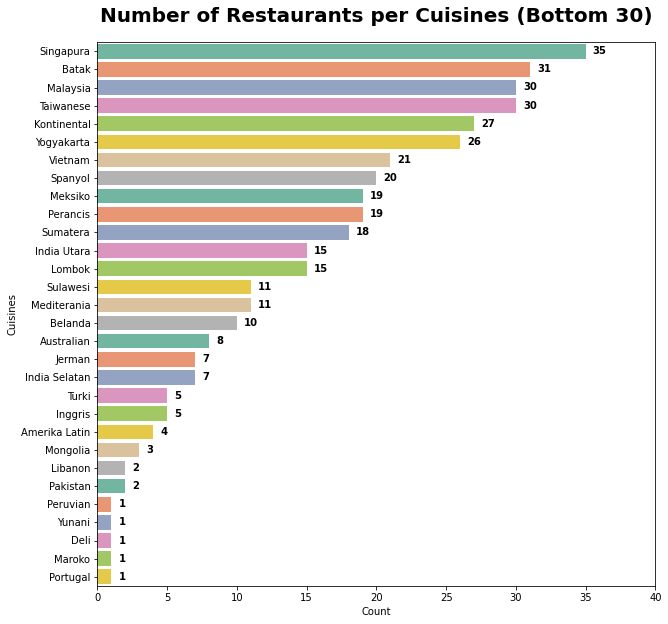

In [18]:
bottom30 = list_cuisines.value_counts().to_frame()[-30:]

fig, ax = plt.subplots(figsize=(10, 10))
g = sns.barplot(data=bottom30.reset_index(), y='index', x='cuisines', palette='Set2', ax=ax)

for patch in g.patches:
    g.text(s=f'{patch.get_width():.0f}', x=patch.get_width()+0.5, y=patch.get_y()+patch.get_height()/2, 
           va='center', fontdict=dict(weight='bold'))

ax.set_xlim(0, 40)
ax.set_title('Number of Restaurants per Cuisines (Bottom 30)', size=20, pad=20, fontweight='bold')
ax.set_ylabel('Cuisines')
ax.set_xlabel('Count')
plt.show()

### Which restaurant serves the most various type of cuisines?

In [19]:
df.cuisines.str.split(', ').apply(lambda x: 0 if x is np.nan else len(x)).max()

8

In [20]:
df[df.cuisines.str.split(', ').apply(lambda x: 0 if x is np.nan else len(x)) == 8]

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
5796,Kafe,PRALIN by Chocolate Monggo,https://www.zomato.com/id/jakarta/pralin-by-ch...,3.800000,22.000000,"Dharmawangsa Square, Dharmawangsa","Dharmawangsa Square, Jl. Dharmawangsa 6, Dharm...","Minuman, Kafe, Desserts, Hanya Minuman, Cemila...",150000.000000,9h - 21h (Sen-Min),NaN,+6282124466781,"Sarapan, Pesan Antar, Bawa Pulang Tersedia, Di...","-6.2531530000,106.8017230000"


In [21]:
df[df.cuisines.str.split(', ').apply(lambda x: 0 if x is np.nan else len(x)) == 7]

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
871,Restoran Kasual,ORO Italian Restaurant & Lounge,https://www.zomato.com/id/jakarta/oro-italian-...,3.400000,10.000000,Kemang,"Jl. Kemang Raya No. 2h, Kemang, Jakarta 12730","Itali, Amerika, Arab, Asia, Australian, Desser...",200000.000000,"24h - 1h, 10h - 24h (Sen-Min)",NaN,"+622122718951, +62895384108179","Pesan Antar, Bawa Pulang Tersedia, Hanya Wine ...","-6.2559180000,106.8109510000"
881,"Kafe, Restoran Kasual",Authentic Coffee,https://www.zomato.com/id/jakarta/authentic-co...,3.100000,24.000000,Pluit,"Jl. Pluit Permai No. 26, Pluit, Jakarta","Kopi, Asia, Barat, Minuman, Kue & Roti, Tea, D...",175000.000000,"8h - 22h (Sen, Sel, Rab, Kam, Min), 8h - 23h (...",NaN,"+6281289033772, +6281219992664","Sarapan, Di dalam ruangan, Wifi Tersedia, Menu...","-6.1155650000,106.7897130000"


## Rating

In [22]:
df.rating.describe().to_frame()

,rating
count,7968.000000
mean,3.559526
std,0.453697
min,2.000000
25%,3.300000
50%,3.600000
75%,3.900000
max,4.900000


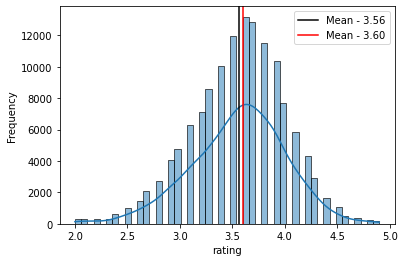

In [23]:
sns.histplot(df.rating, kde=True, stat='frequency')
plt.axvline(df.rating.mean(), color='k', label=f'Mean - {df.rating.mean():.2f}')
plt.axvline(df.rating.median(), color='r', label=f'Mean - {df.rating.median():.2f}')

plt.legend()

### Which restaurants has the highest rating?

In [24]:
df[df.rating == df.rating.max()].sort_values('review_count', ascending=False)

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
50,"Restoran Fine Dining, Bar",OKU - Hotel Indonesia Kempinski,https://www.zomato.com/id/jakarta/oku-hotel-in...,4.900000,931.000000,"Hotel Indonesia Kempinski, Thamrin","Hotel Indonesia Kempinski, Jl. M. H. Thamrin, ...","Jepang, Sushi",900000.000000,"12h - 14h 30m, 18h - 21h (Sen-Min)","Luxury Dining, Rolling in the Sushi, Jakarta's...",021 80602045 ext:249,"Pesan Antar, Alkohol Tersedia, Reservasi meja ...","-6.1956170000,106.8223590000"
155,Restoran Fine Dining,Namaaz Dining,https://www.zomato.com/id/jakarta/namaaz-dinin...,4.900000,927.000000,Senopati,"Jl. Gunawarman No. 42, Senopati, Jakarta",Indonesia,2400000.000000,"Tutup (Sen, Min), 19h - 22h (Sel-Sab)","Luxury Dining, Jakarta's Finest",+622133061000,"Alkohol Tersedia, Hanya untuk reservasi meja, ...","-6.2385876732,106.8069630861"
535,Quick Bites,Bakso Akiaw 99,https://www.zomato.com/id/jakarta/bakso-akiaw-...,4.900000,811.000000,Mangga Besar,"Jl. Mangga Besar Raya No. 2B, Mangga Besar, Ja...","Bakso, Chinese",120000.000000,14h - 23h (Sen-Min),"Through Histories, Jakarta's Finest",+62216291419,"Bawa Pulang Tersedia, Tempat duduk di luar, Di...","-6.1500460000,106.8176670000"
173,Restoran Kasual,Layar Seafood,https://www.zomato.com/id/jakarta/layar-seafoo...,4.900000,616.000000,Meruya,"Jl. Pesanggrahan Raya No. 80, Meruya, Jakarta",Seafood,200000.000000,11h - 20h (Sen-Min),Jakarta's Finest,"+622158907223, +622158907224","Wifi Tersedia, Di dalam ruangan, Parkir Valet ...","-6.1956200000,106.7555780000"
28,Toko Dessert,Cold Moo,https://www.zomato.com/id/jakarta/cold-moo-dha...,4.900000,582.000000,Dharmawangsa,"Jl. Dharmawangsa VI, No. 20, Pulo 12160","Desserts, Ice Cream",80000.000000,"Tutup (Sen-Sel),9h - 18h (Rab-Min)","Amazingly Sweet!, Jakarta's Finest",+6281386777661,"Bawa Pulang Tersedia, Di dalam ruangan, Desser...","-6.2534988834,106.8013254181"
4197,Kaki Lima,Martabak Favourite,https://www.zomato.com/id/jakarta/martabak-fav...,4.900000,481.000000,Rawamangun,"Jl. Balai Pustaka, Rawamangun, Jakarta","Makanan Jalanan, Martabak",80000.000000,16h 30m - 24h (Sen-Min),"Martabak Paling Enak, Kaki Lima Jakarta Terbai...","+628161922336, +6285718250895","Pesan Antar, Bawa Pulang Tersedia, Desserts an...","-6.2004980000,106.8859100000"
382,Restoran Kasual,Angke Ketapang,https://www.zomato.com/id/jakarta/angke-ketapa...,4.900000,446.000000,Gajah Mada,"Komplek Ketapang Indah, Jl. K. H. Zainul Arifi...",Chinese,450000.000000,"10h - 15h, 17h - 22h (Sen-Min)","Through Histories, Jakarta's Finest",+62216343030,"Pesan Antar, Bawa Pulang Tersedia, Reservasi m...","-6.1597180000,106.8171320000"
1454,Toko Kue & Roti,Francis Artisan Bakery,https://www.zomato.com/id/jakarta/francis-arti...,4.900000,417.000000,"Grand Indonesia Mall, Thamrin","Grand Indonesia Mall, East Mall, Lantai Lower ...",Kue & Roti,70000.000000,10h - 22h (Sen-Min),Jakarta's Finest,+622123580019,"Hanya Bawa Pulang, Desserts and Bakes, Prasmanan","-6.1955460000,106.8214010000"
11,Restoran Kasual,WAKI Japanese BBQ Dining,https://www.zomato.com/id/jakarta/waki-japanes...,4.900000,2.000000,Thamrin,"Lantai 1, Jl. Tanjung Karang No. 5, Thamrin, J...","Jepang, Barbekyu",300000.000000,11h - 22h (Sen-Min),Jakarta's Finest,+6281290109624,"Pesan Antar, Bawa Pulang Tersedia, Hanya Wine ...","-6.2011260000,106.8223060000"
129,Restoran Fine Dining,The Café - Hotel Mulia,https://www.zomato.com/id/jakarta/the-café-hot...,4.900000,2.000000,"Hotel Mulia, Senayan","Hotel Mulia, Jl. Asia Afrika, Senayan, Jakarta","Indonesia, Barat",1200000.000000,24 Jam (Sen-Min),"All You Can Eat!, Luxury Dining, Jakarta's Finest","+62215747777, +62215753270","Sarapan, Hanya Wine dan Bir, Parkir Valet Ters...","-6.2149550000,106.7970460000"


### Which restaurant has the lowest rating?

In [25]:
df[df.rating == df.rating.min()].sort_values('review_count', ascending=False)

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
3841,Quick Bites,Bamboo Dimsum,https://www.zomato.com/id/jakarta/bamboo-dimsu...,2.000000,613.000000,Tebet,"Jl. Tebet Raya No. 78B, Tebet, Jakarta","Chinese, Dimsum",120000.000000,"10h - 22h (Sen, Sel, Rab, Kam, Min), 10h - 23h...",NaN,+622145879292,"Sarapan, Bawa Pulang Tersedia, Di dalam ruanga...","-6.2279980000,106.8565640000"
3834,Pujasera,Miting Lobster,https://www.zomato.com/id/jakarta/miting-lobst...,2.000000,578.000000,"Rumah Genjing, Cempaka Putih","Rumah Genjing, Jl. Pramuka Raya No. 56, Cempak...",Seafood,80000.000000,11h - 24h (Sen-Min),NaN,+6281316562548,"Bawa Pulang Tersedia, Tempat duduk di luar","-6.1933650000,106.8618100000"
3897,Quick Bites,Mecah Piting,https://www.zomato.com/id/jakarta/mecah-piting...,2.000000,407.000000,Tebet,"Jl. Tebet Barat IX No. 30, Tebet, Jakarta",Seafood,135000.000000,"11h - 16h, 18h - 22h (Sen-Min)",NaN,"+6285773297233, +6281316562548","Bawa Pulang Tersedia, Reservasi meja direkomen...","-6.2385300000,106.8495940000"
3828,Kaki Lima,Nasi Goreng Gila Gondrong Obama 01,https://www.zomato.com/id/jakarta/nasi-goreng-...,2.000000,225.000000,Menteng,"Jl. Besuki No. 4A, Menteng, Jakarta",Indonesia,70000.000000,17h - 24h (Sen-Min),NaN,+6287886686345,"Bawa Pulang Tersedia, Tempat duduk di luar","-6.1983840000,106.8290850000"
6799,Restoran Kasual,Riung Sunda,https://www.zomato.com/id/jakarta/riung-sunda-...,2.000000,63.000000,"Central Park, Tanjung Duren","Central Park, Lantai Lower Ground, Jl. Letjen ...","Sunda, Indonesia",200000.000000,10h - 22h (Sen-Min),NaN,+622156985394,"Wifi Tersedia, Reservasi meja direkomendasikan...","-6.1782880000,106.7902970000"
4843,Quick Bites,QQ Kopitiam,https://www.zomato.com/id/jakarta/qq-kopitiam-...,2.000000,57.000000,"Plaza Indonesia, Thamrin","Plaza Indonesia, Lantai 5, Jl MH Thamrin, Tham...","Peranakan, Indonesia, Desserts",150000.000000,10h - 22h (Sen-Min),NaN,+622129923699,"Bawa Pulang Tersedia, Di dalam ruangan","-6.1931280000,106.8224810000"
2812,Quick Bites,Talaga Kuring,https://www.zomato.com/id/jakarta/talaga-kurin...,2.000000,42.000000,Sentul,"Komplek Graha Utama, Jl. Bukit Sentul, Sentul,...",Sunda,250000.000000,"Tutup (Sen),10h - 22h (Sel-Min)",NaN,+622122930239,"Bawa Pulang Tersedia, Di dalam ruangan","-6.5755140000,106.8644510000"
7451,Quick Bites,Nasi Tempong Sambal Jablay,https://www.zomato.com/id/jakarta/nasi-tempong...,2.000000,26.000000,Palmerah,"Jl. Kh. Syahdan No. 36B, Palmerah, Jakarta",Indonesia,50000.000000,9h - 21h (Sen-Min),NaN,+6281212777028,"Bawa Pulang Tersedia, Tempat duduk di luar","-6.2006750000,106.7838800000"
6245,Kios,Bamboo Dimsum,https://www.zomato.com/id/jakarta/bamboo-dimsu...,2.000000,10.000000,"Ruko New Castle, Cipondoh","Ruko Newcastle, Jl. Green Lake City Boulevard ...",Dimsum,80000.000000,"10h - 22h (Sen-Kam),10h - 23h (Jum-Min)",NaN,+62214587685,"Bawa Pulang Tersedia, Di dalam ruangan","-6.1818265494,106.7103271186"
8479,Quick Bites,Salthings,https://www.zomato.com/id/jakarta/salthings-ku...,2.000000,5.000000,"Food Colony, Kuningan","Food Colony, Jl. H.R. Rasuna Said No. 22, Kuni...",Indonesia,100000.000000,10h - 22h (Sen-Min),NaN,+6285341509555,"Bawa Pulang Tersedia, Di dalam ruangan","-6.2218595502,106.8338019401"


## Collections

### How many collections in the data?

In [26]:
df_collections = df.copy()
df_collections['collections'] = df_collections['collections'].str.split(', ')
df_collections = df_collections.explode('collections')
df_collections

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869","Bawa Pulang Tersedia, Alkohol Tersedia, Reserv...","-6.2162290000,106.7978830000"
1,Restoran Kasual,Furusato Izakaya,https://www.zomato.com/id/jakarta/furusato-iza...,4.300000,152.000000,Sudirman,"Jl. Jend Sudirman No. 36, Sudirman, Jakarta 10210",Jepang,500000.000000,"11h 30m - 14h 30m, 18h - 21h (Sen-Jum),11h - 1...",NaN,+628119250020,"Hanya Wine dan Bir, Parkir Valet Tersedia, Are...","-6.2146764771,106.8168163228"
2,Restoran Kasual,Animale Restaurant,https://www.zomato.com/id/jakarta/animale-rest...,4.300000,125.000000,Setiabudi,"MD Place Bulding, Lantai 11, Jl. Setiabudi Sel...","Amerika, Mediterania",500000.000000,"12h - 14h 30m, 17h 30m - 22h (Sen-Sab),12h 30m...",NaN,"+622129669260, +6287772646253","Bawa Pulang Tersedia, Hanya Bir, Reservasi mej...","-6.2086409900,106.8284083530"
3,Restoran Kasual,Wolfgang's Steakhouse,https://www.zomato.com/id/jakarta/wolfgangs-st...,3.400000,54.000000,SCBD,"Elysee Building, Level 6 Rooftop, LOT 21 SCBD\...",Steak,500000.000000,11h 30m - 22h (Sen-Min),NaN,+6262811150955,"Bawa Pulang Tersedia, Tempat duduk di luar, Re...","-6.2257438285,106.8130087852"
4,Restoran Kasual,Medja Restaurant,https://www.zomato.com/id/jakarta/medja-restau...,4.000000,277.000000,Bogor Timur,"Jl. Pajajaran Indah V No. 6, Bogor Timur, Bogor",Indonesia,360000.000000,"11h - 21h (Sen-Jum),10h - 21h (Sab-Min)",NaN,+622518385841,"Bawa Pulang Tersedia, Hanya Bir, Tempat duduk ...","-6.6096150000,106.8123640000"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15030,Toko Minuman,Pattaya,https://www.zomato.com/id/jakarta/pattaya-cila...,3.500000,4.000000,"Ampera Garden, Cilandak","Ampera Garden Food Festival, Jl. Ampera Raya N...","Minuman, Bubble Tea, Thai",50000.000000,10h - 23h (Sen-Min),NaN,+622122785259,"Bawa Pulang Tersedia, Tempat duduk di luar, Di...","-6.2889060000,106.8173260000"
15032,Quick Bites,Ayam Goreng/Bakar Borobudur,https://www.zomato.com/id/jakarta/ayam-goreng-...,3.100000,12.000000,Gunung Sahari,"Jl. Pademangan Raya 4 No. 47, Gunung Sahari, J...",Jawa,80000.000000,9h - 22h (Sen-Min),NaN,+622164712873,"Pesan Antar, Bawa Pulang Tersedia, Di dalam ru...","-6.1386530000,106.8408870000"
15033,Quick Bites,Dapur Wonogiri,https://www.zomato.com/id/jakarta/dapur-wonogi...,3.300000,6.000000,Cilodong,"Jl. Tole Iskandar No. 7, Cilodong, Depok 16415",Indonesia,100000.000000,9h - 22h (Sen-Min),NaN,"+622177822474, +622177822507, +6282123454554","Pesan Antar, Bawa Pulang Tersedia, Tempat dudu...","-6.4060150000,106.8513680000"
15035,Quick Bites,Kwetiau Hotplate,https://www.zomato.com/id/jakarta/kwetiau-hotp...,2.900000,16.000000,Tanjung Duren,"Jl. Tanjung Duren Raya No. 66, Tanjung Duren, ...","Dimsum, Bakmi",100000.000000,10h - 22h (Sen-Min),NaN,+6281380553378,"Bawa Pulang Tersedia, Tempat duduk di luar, Di...","-6.1748580000,106.7834460000"


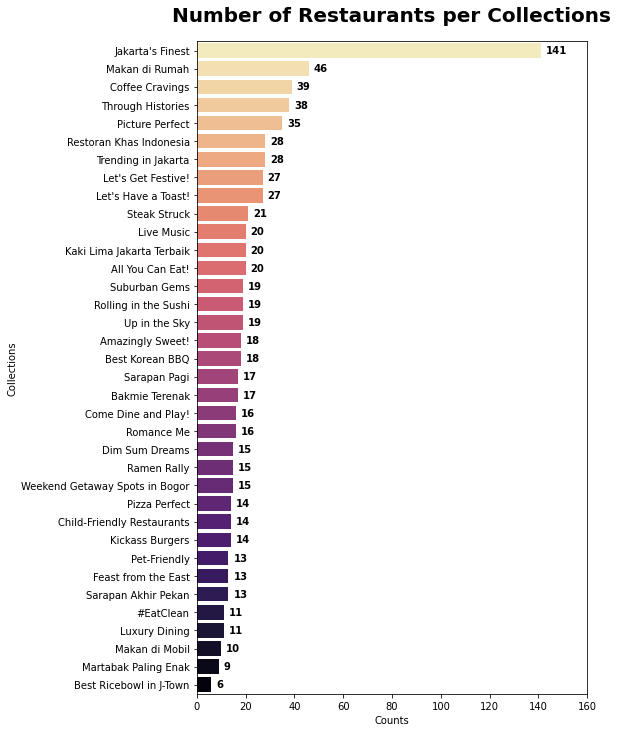

In [27]:
fig, ax = plt.subplots(figsize=(7, 12))
g = sns.countplot(data=df_collections.replace(np.nan, 'No Collections'), y='collections', 
                  order=df_collections.collections.value_counts().index, ax=ax, palette='magma_r')

for idx, p in enumerate(g.patches):
    g.text(s=p.get_width(), x=p.get_width()+2, y=idx, va='center', fontdict=dict(weight='bold'))

g.set_xlim(0, 160)
g.set_xlabel('Counts')
g.set_ylabel('Collections')
g.set_title('Number of Restaurants per Collections', size=20, pad=20, fontweight='bold')
plt.show()

### Which restaurants is the most featured in collections?

In [28]:
most_col = df_collections.dropna(subset=['collections']).groupby('res_link').agg(count=('category', len)).sort_values('count', ascending=False)
most_col

,count
res_link,
https://www.zomato.com/id/jakarta/liberta-sudirman,5
https://www.zomato.com/id/jakarta/honu-poké-matcha-bar-kemang,5
https://www.zomato.com/id/jakarta/tucanos-churrascaria-brazilian-bbq-buffet-sudirman,5
https://www.zomato.com/id/jakarta/the-edge-kemang,4
https://www.zomato.com/id/jakarta/tugu-kunstkring-paleis-menteng,4
...,...
https://www.zomato.com/id/jakarta/lokal-deli-coffee-and-cakes-kemang,1
https://www.zomato.com/id/jakarta/cafe-batavia-kota,1
https://www.zomato.com/id/jakarta/little-talk-coffee-jatiasih-bekasi,1


In [29]:
most_col_index = most_col[most_col['count'] == most_col['count'].max()].index
most_col_index

Index(['https://www.zomato.com/id/jakarta/liberta-sudirman',
       'https://www.zomato.com/id/jakarta/honu-poké-matcha-bar-kemang',
       'https://www.zomato.com/id/jakarta/tucanos-churrascaria-brazilian-bbq-buffet-sudirman'],
      dtype='object', name='res_link')

In [30]:
most_col_rest = df[df.res_link.isin(most_col_index)][['title', 'collections']]
col_expand = most_col_rest['collections'].str.split(', ', expand=True)
pd.concat([most_col_rest, col_expand], axis=1)

,title,collections,0,1,2,3,4
48,Tucano's Churrascaria - Brazilian BBQ & Buffet,"All You Can Eat!, Steak Struck, Makan di Rumah...",All You Can Eat!,Steak Struck,Makan di Rumah,Jakarta's Finest,Let's Get Festive!
185,HONU Poké & Matcha Bar,"Picture Perfect, Jakarta's Finest, #EatClean, ...",Picture Perfect,Jakarta's Finest,#EatClean,Pet-Friendly,Makan di Rumah
300,Liberta,"Let's Have a Toast!, Pizza Perfect, Romance Me...",Let's Have a Toast!,Pizza Perfect,Romance Me,Amazingly Sweet!,Let's Get Festive!


## Features

In [31]:
df_features = df.copy()
df_features['features'] = df_features['features'].str.split(', ')
df_features = df_features.explode('features')
df_features.head()

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869",Bawa Pulang Tersedia,"-6.2162290000,106.7978830000"
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869",Alkohol Tersedia,"-6.2162290000,106.7978830000"
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869",Reservasi meja direkomendasikan,"-6.2162290000,106.7978830000"
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869",Wifi Tersedia,"-6.2162290000,106.7978830000"
0,Restoran Kasual,Acta Brasserie,https://www.zomato.com/id/jakarta/acta-brasser...,4.000000,174.000000,"The MAJ Senayan, Senayan","The MAJ Senayan, Senayan National Golf Club, J...","Barat, Asia, Grill House",350000.000000,"11h - 19h (Sen-Jum),9h - 19h (Sab-Min)",Makan di Rumah,"+62811185427, +622150851869",Parkir Valet Tersedia,"-6.2162290000,106.7978830000"


### How many features are there?

In [32]:
count_feat = df_features.reset_index().groupby('features').count()['index'].sort_values(ascending=False).to_frame()
count_feat

,index
features,
Di dalam ruangan,12523
Bawa Pulang Tersedia,12246
Wifi Tersedia,3962
Area Merokok,3533
Tempat duduk di luar,3354
Sarapan,2987
Pesan Antar,2673
Reservasi meja direkomendasikan,2484
Desserts and Bakes,1485


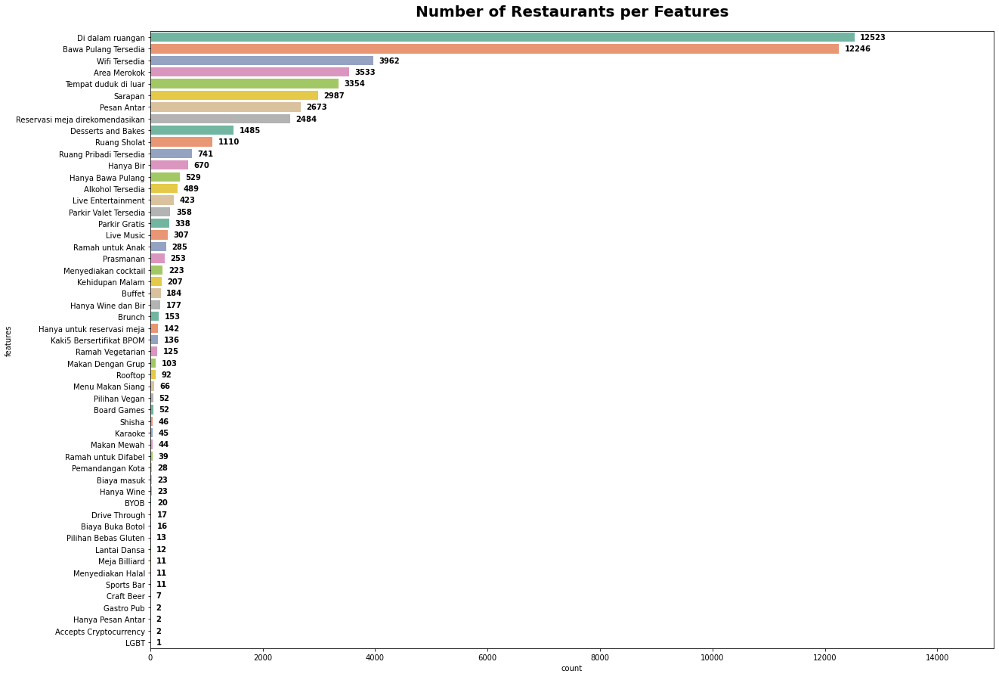

In [33]:
fig, ax = plt.subplots(figsize=(20, 15))
g = sns.countplot(data=df_features, y='features', order=count_feat.index, palette='Set2')

for idx, p in enumerate(g.patches):
    g.text(s=p.get_width(), x=p.get_width()+100, y=idx, va='center', fontdict={'weight':'bold'})

g.set_xlim(0, 15000)
g.set_title('Number of Restaurants per Features', size=20, pad=20, fontweight='bold')
plt.show()

### Which restaurant has the most features?

In [34]:
feat_byres = df_features.groupby('res_link').count().sort_values('features', ascending=False)[['features']].head() 
feat_byres

,features
res_link,
https://www.zomato.com/id/jakarta/anelia-coffee-and-resto-melawai,20
https://www.zomato.com/id/jakarta/expatriate-italian-restaurant-kelapa-gading,18
https://www.zomato.com/id/jakarta/egghotel-1-setiabudi,17
https://www.zomato.com/id/jakarta/penny-lane-bar-resto-cempaka-putih,17
https://www.zomato.com/id/jakarta/madame-delima-1-cikini,17


In [35]:
most_feat_res = df.merge(feat_byres.reset_index(), on='res_link', suffixes=('_list', '_count'))[['title', 'features_count', 'features_list']]
expand_res = most_feat_res['features_list'].str.split(', ', expand=True)
most_feat_res.join(expand_res).sort_values('features_count', ascending=False)

,title,features_count,features_list,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19
4,Anelia Coffee and Resto,20,"Sarapan, Bawa Pulang Tersedia, Hanya Bir, Kara...",Sarapan,Bawa Pulang Tersedia,Hanya Bir,Karaoke,Menyediakan cocktail,Ramah untuk Anak,Ruang Pribadi Tersedia,Area Merokok,Brunch,Makan Dengan Grup,Menu Makan Siang,Parkir Gratis,Kehidupan Malam,Tempat duduk di luar,Di dalam ruangan,Ramah untuk Difabel,Ruang Sholat,Prasmanan,Wifi Tersedia,Desserts and Bakes
0,Expatriate Italian Restaurant,18,"Sarapan, Pesan Antar, Bawa Pulang Tersedia, Ha...",Sarapan,Pesan Antar,Bawa Pulang Tersedia,Hanya Wine dan Bir,Brunch,Live Entertainment,Tempat duduk di luar,Di dalam ruangan,Wifi Tersedia,Menyediakan cocktail,Area Merokok,Desserts and Bakes,Reservasi meja direkomendasikan,Ruang Sholat,Ramah Vegetarian,Biaya Buka Botol,Live Music,Hanya untuk reservasi meja,None,None
1,Egghotel,17,"Hanya Wine dan Bir, Tempat duduk di luar, Roof...",Hanya Wine dan Bir,Tempat duduk di luar,Rooftop,Reservasi meja direkomendasikan,Area Merokok,Ramah Vegetarian,Makan Dengan Grup,Live Entertainment,Craft Beer,Di dalam ruangan,Menyediakan cocktail,Ruang Pribadi Tersedia,Wifi Tersedia,Brunch,Menu Makan Siang,Parkir Gratis,Pemandangan Kota,None,None,None
2,Penny Lane Bar & Resto,17,"Bawa Pulang Tersedia, Alkohol Tersedia, BYOB, ...",Bawa Pulang Tersedia,Alkohol Tersedia,BYOB,Live Music,Menyediakan cocktail,Reservasi meja direkomendasikan,Ruang Sholat,Wifi Tersedia,Makan Dengan Grup,Live Entertainment,Meja Billiard,Tempat duduk di luar,Sports Bar,Di dalam ruangan,Area Merokok,Kehidupan Malam,Parkir Valet Tersedia,None,None,None
3,Madame Delima,17,"Pesan Antar, Bawa Pulang Tersedia, Parkir Grat...",Pesan Antar,Bawa Pulang Tersedia,Parkir Gratis,Parkir Valet Tersedia,Live Music,Rooftop,Hanya untuk reservasi meja,Ramah untuk Anak,Ruang Sholat,Area Merokok,Live Entertainment,Tempat duduk di luar,Di dalam ruangan,Ruang Pribadi Tersedia,Wifi Tersedia,Brunch,Desserts and Bakes,None,None,None


## Review Counts

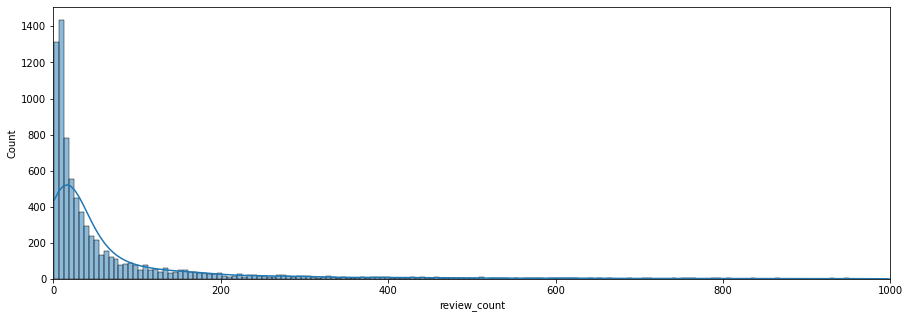

In [36]:
fig = plt.figure(figsize=(15, 5))
g = sns.histplot(df['review_count'], kde=True)

g.set_xlim(0, 1000)
plt.show()

### Which restaurant has the most reviews?

In [37]:
df.sort_values('review_count', ascending=False).head(5)

,category,title,res_link,rating,review_count,locality,location,cuisines,price_for_two,time,collections,phone,features,geo_location
282,Restoran Kasual,Bumi Sampireun,https://www.zomato.com/id/jakarta/bumi-sampire...,4.300000,998.000000,Cisarua,"Vimala Hills, Jl. Puncak Raya, Cisarua, Bogor",Indonesia,200000.000000,"11h - 20h (Sen-Jum),10h - 20h (Sab-Min)","Weekend Getaway Spots in Bogor, Restoran Khas ...",+622518292999,"Pesan Antar, Bawa Pulang Tersedia, Ruang Priba...","-6.6664800000,106.8703740000"
14,"Restoran Fine Dining, Bar",Henshin - The Westin Jakarta,https://www.zomato.com/id/henshin,4.500000,997.000000,"The Westin Jakarta, Kuningan","The Westin Jakarta, Lantai 67-69, Jl. H. R. Ra...","Peruvian, Jepang",1400000.000000,"Tutup (Sen-Sel),17h - 21h (Rab-Min)","Jakarta's Finest, Up in the Sky, Romance Me","+622127887768, +622127887788","Alkohol Tersedia, Area Merokok, Live Music, Ru...","-6.2242916437,106.8338166922"
119,Restoran Kasual,NOBLE by Zab Thai,https://www.zomato.com/id/jakarta/noble-by-zab...,4.700000,987.000000,Senopati,"Jl. Gunawarman No. 41, Senopati, Jakarta 12110",Thai,300000.000000,10h - 20h (Sen-Min),Jakarta's Finest,"+6281319089090, +622127939193","Pesan Antar, Hanya Wine dan Bir, Di dalam ruan...","-6.2359846670,106.8077814952"
287,Restoran Kasual,Marutama Ra-men,https://www.zomato.com/id/jakarta/marutama-ra-...,4.800000,983.000000,"Sentral Senayan 1, Senayan","Sentral Senayan 1, Lantai Basement, Jl. Asia A...","Ramen, Jepang",250000.000000,11h 30m - 20h 30m (Sen-Min),"Ramen Rally, Jakarta's Finest",+62215724050,"Bawa Pulang Tersedia, Hanya Bir, Reservasi mej...","-6.2241020000,106.7994050000"
283,Kafe,Kedai Filosofi Kopi,https://www.zomato.com/id/jakarta/kedai-filoso...,4.100000,982.000000,Melawai,"Jl. Melawai 6, Melawai, Jakarta",Kopi,100000.000000,"11h - 23h (Sen-Jum),7h - 23h (Sab-Min)",Coffee Cravings,+622173910939,"Bawa Pulang Tersedia, Di dalam ruangan","-6.2448578322,106.7997784540"


## Location

### Hotspot Location For Hotspot

In [38]:
geolocator = Nominatim(user_agent='IndoGeocoders')
reverse = RateLimiter(partial(geolocator.reverse, language='id'), min_delay_seconds=0.1)

In [39]:
heatmap_raw = df.dropna(axis=0, subset=['geo_location'])
heatmap_geo = heatmap_raw['geo_location'].str.split(',', expand=True).reset_index(drop=True)
heatmap_value = pd.DataFrame(MinMaxScaler(feature_range=(1,5)).fit_transform(heatmap_raw[['price_for_two']]))
heatmap_data = pd.concat([heatmap_geo, heatmap_value], axis=1, ignore_index=True)

In [40]:
location = geolocator.geocode('Jakarta, ID').latitude, geolocator.geocode('Jakarta, ID').longitude
base_map = folium.Map(location=location, tiles='CartoDB positron', zoom_start=12)
HeatMap(heatmap_geo.to_numpy(), radius=20, min_opacity=0.2).add_to(folium.FeatureGroup(name='HeatMap').add_to(base_map))
folium.LayerControl().add_to(base_map)

base_map

## Review Count and Rating

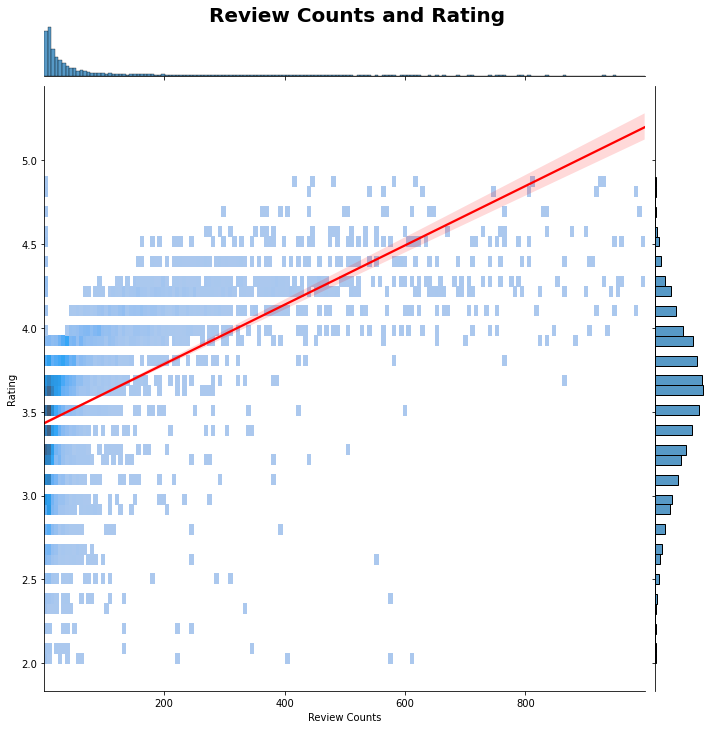

In [41]:
g1 = sns.jointplot(data=df, x='review_count', y='rating', kind='hist', height=10, ratio=10)
g2 = sns.regplot(data=df, x='review_count', y='rating', scatter=False, ax=g1.ax_joint, color='red')

g2.set_xlabel('Review Counts')
g2.set_ylabel('Rating')
g1.fig.suptitle('Review Counts and Rating', size=20, y=1.01, fontweight='bold')
plt.show()

## Location and Price

### On Logarithmic Scale

In [42]:
data = df.dropna(axis=0, subset=['geo_location', 'price_for_two']).copy()

In [43]:
data.loc[:, 'price_for_two'] = MinMaxScaler(feature_range=(1,16)).fit_transform(data[['price_for_two']])

In [44]:
location = geolocator.geocode('Jakarta, ID').latitude, geolocator.geocode('Jakarta, ID').longitude
base_map = folium.Map(location=location, tiles='CartoDB dark_matter', zoom_start=12)#, max_zoom=16, min_zoom=10)
colormap = cm.LinearColormap(colors=["#390099","#9e0059","#ff0054","#ff5400","#ffbd00"], 
                             index=(17-np.geomspace(1, 16, 5))[::-1], vmin=1, vmax=16)

for idx, row in data.sort_values('price_for_two').iterrows():
    x, y = tuple(map(float, row['geo_location'].split(',')))
        
    folium.CircleMarker(location=(x, y), fill_color=colormap(row['price_for_two']), color=None, radius=5, fill_opacity=0.5
                       ).add_to(base_map)

colormap.add_to(base_map)
folium.LayerControl().add_to(base_map)

base_map

### On Percentile Scale

In [45]:
data = df.dropna(axis=0, subset=['geo_location', 'price_for_two']).copy()

In [46]:
index = percentile_df[:-1].values.reshape(-1)[1::2]
index

array([  60000.,   80000.,  100000.,  150000., 3500000.])

In [47]:
location = geolocator.geocode('Jakarta, ID').latitude, geolocator.geocode('Jakarta, ID').longitude
base_map = folium.Map(location=location, tiles='CartoDB dark_matter', zoom_start=12)#, max_zoom=16, min_zoom=10)
colormap = cm.LinearColormap(colors=['#'+i for i in ("247ba0","70c1b3","b2dbbf","f3ffbd","ff1654")], 
                             index=index, vmin=index[0], vmax=index[-1])
cbar =  cm.LinearColormap(colors=['#'+i for i in ("247ba0","70c1b3","b2dbbf","f3ffbd","ff1654")], 
                          index=np.linspace(0,1,5), vmin=0, vmax=1)

for idx, row in data.sort_values('price_for_two').iterrows():
    x, y = tuple(map(float, row['geo_location'].split(',')))
        
    folium.CircleMarker(location=(x, y), fill_color=colormap(row['price_for_two']), color=None, radius=5, fill_opacity=0.5
                       ).add_to(base_map)

cbar.add_to(base_map)
folium.LayerControl().add_to(base_map)

base_map

## Location and Rating

In [9]:
geolocator = Nominatim(user_agent='IndoGeocoders')
reverse = RateLimiter(partial(geolocator.reverse, language='id'), min_delay_seconds=0.1)

In [10]:
data = df.dropna(axis=0, subset=['geo_location', 'rating']).copy()

In [20]:
location = geolocator.geocode('Jakarta, ID').latitude, geolocator.geocode('Jakarta, ID').longitude
base_map = folium.Map(location=location, tiles='CartoDB dark_matter', zoom_start=12)#, max_zoom=16, min_zoom=10)
colormap = cm.LinearColormap(colors=['#004ca3', '#8a51a5', '#cb5e99', '#f47b89', '#ffa47e', '#ffd286', '#ffffa6'], 
                             index=np.linspace(0, 5, 7), vmin=0, vmax=5, caption='User Rating')

for idx, row in data.sort_values('rating').iterrows():
    x, y = tuple(map(float, row['geo_location'].split(',')))
    
    folium.CircleMarker(location=(x, y), radius=5, color=None,
                        fill_color=colormap(row['rating']), fill_opacity=0.5
                       ).add_to(base_map)

colormap.add_to(base_map)
folium.LayerControl().add_to(base_map)

base_map

## Location and Review Count

In [22]:
data = df.dropna(axis=0, subset=['geo_location', 'review_count']).copy()

In [27]:
index = np.linspace(data.review_count.min(), data.review_count.max(), 5)
index

array([  1.  , 250.25, 499.5 , 748.75, 998.  ])

In [30]:
location = geolocator.geocode('Jakarta, ID').latitude, geolocator.geocode('Jakarta, ID').longitude
base_map = folium.Map(location=location, tiles='CartoDB dark_matter', zoom_start=12)#, max_zoom=16, min_zoom=10)
colormap = cm.LinearColormap(colors=['#'+i for i in ("ef476f","ffd166","06d6a0","118ab2","073b4c")][::-1], 
                             index=index, vmin=index[0], vmax=index[-1], caption='Review Counts')

for idx, row in data.sort_values('review_count').iterrows():
    x, y = tuple(map(float, row['geo_location'].split(',')))
    
    folium.CircleMarker(location=(x, y), radius=5, color=None,
                        fill_color=colormap(row['review_count']), fill_opacity=0.6
                       ).add_to(base_map)

colormap.add_to(base_map)
folium.LayerControl().add_to(base_map)

base_map

## Review Counts and Price for Two

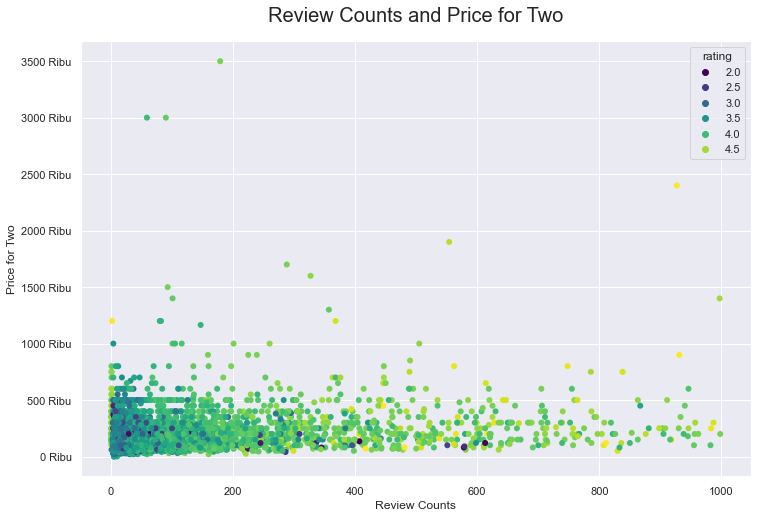

In [46]:
sns.set()

fig, ax = plt.subplots(figsize=(12, 8))
g = sns.scatterplot(data=df, x='review_count', y='price_for_two', hue='rating', ax=ax, linewidth=0, palette='viridis')

g.yaxis.set_major_formatter(lambda x, pos: f'{x/10**3:.0f} Ribu')
g.set_xlabel('Review Counts')
g.set_ylabel('Price for Two')
g.set_title('Review Counts and Price for Two', size=20, pad=20)

plt.show()

## Price for Two and Rating

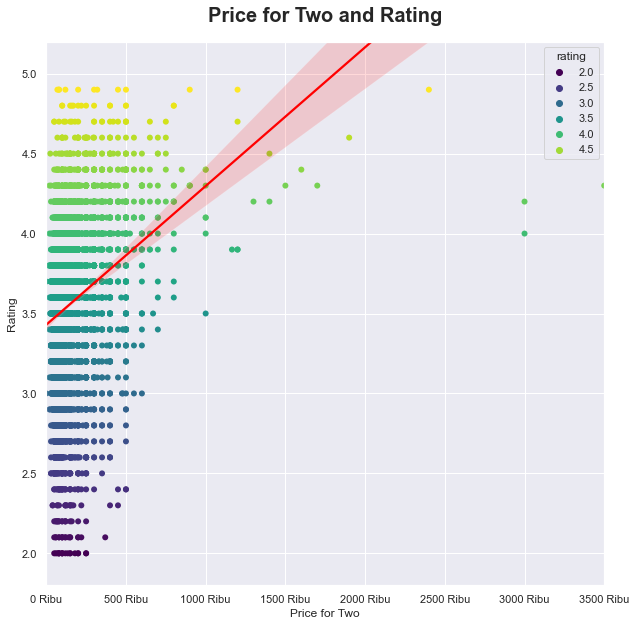

In [82]:
fig, ax = plt.subplots(figsize=(10, 10))

g1 = sns.scatterplot(data=df, x='price_for_two', y='rating', palette='viridis', ax=ax, hue='rating', linewidth=0)
g2 = sns.regplot(data=df, x='price_for_two', y='rating', ax=ax, color='red', scatter=False)

g1.xaxis.set_major_formatter(lambda x, pos: f'{x/10**3:.0f} Ribu')
g2.set_xlim(0, 3500000)
g2.set_ylim(1.8, 5.2)

ax.set_ylabel('Rating')
ax.set_xlabel('Price for Two')
ax.set_title('Price for Two and Rating', size=20, pad=20, fontweight='bold')

plt.show()

## Price for Two and Categories

In [180]:
check = df.copy()
check['category'] = check.category.str.split(', ')
check = data.explode('category')

In [181]:
data = df.copy()
data['category'] = data.category.str.split(', ')
data = data.explode('category')
top_cat = data.category.value_counts().index
order_by_median = data[data.category.isin(top20_cat)].groupby('category')\
                    .agg(median=('price_for_two', 'median')).sort_values('median', ascending=False).index

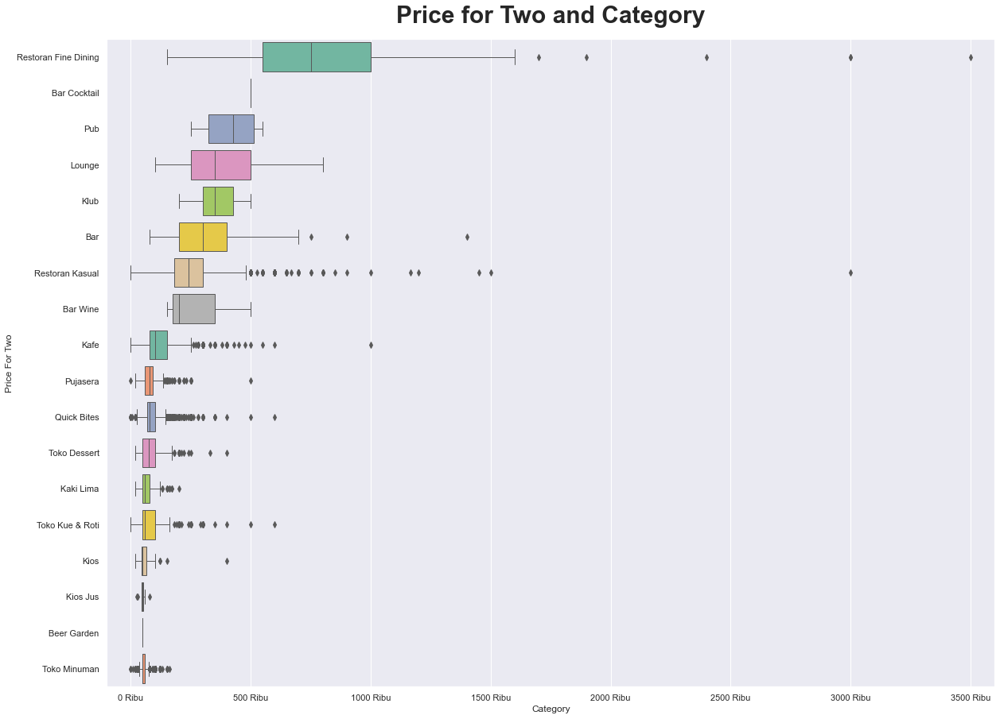

In [182]:
fig, ax = plt.subplots(figsize=(20, 15))

g = sns.boxplot(data=data, y='category', x='price_for_two', order=order_by_median, palette='Set2', linewidth=1, ax=ax)

g.set_xlim(-100000, 3.6*10**6)
g.set_title('Price for Two and Category', size=30, pad=20, weight='bold')
g.xaxis.set_major_formatter(lambda x, pos: f'{x/10**3:.0f} Ribu')
g.set_xlabel('Category')
g.set_ylabel('Price For Two')

plt.show()

## Price For Two and Cuisines

In [183]:
data = df.copy()
data['cuisines'] = data.cuisines.str.split(', ')
data = data.explode('cuisines')
top20_cuisines = data.cuisines.value_counts().head(20).index
order_by_median = data[data.cuisines.isin(top20_cuisines)].groupby('cuisines')\
                    .agg(median=('price_for_two', 'median')).sort_values('median', ascending=False).index

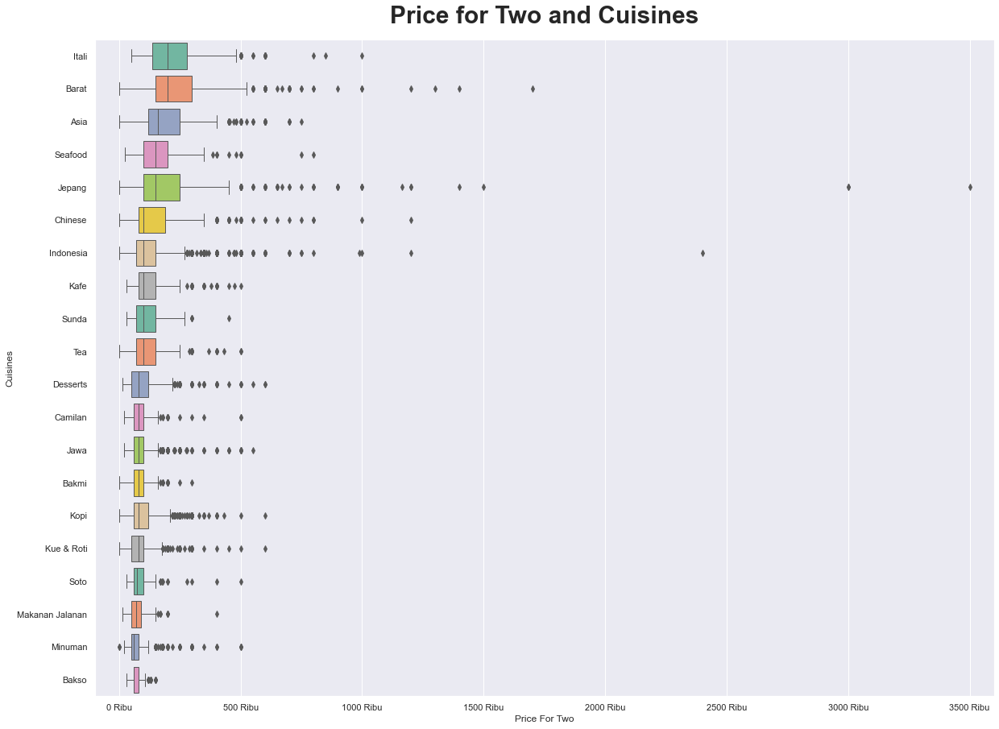

In [170]:
fig, ax = plt.subplots(figsize=(20, 15))

g = sns.boxplot(data=data, y='cuisines', x='price_for_two', order=order_by_median, palette='Set2', linewidth=1, ax=ax)

g.set_xlim(-100000, 3.6*10**6)
g.set_title('Price for Two and Cuisines', size=30, pad=20, weight='bold')
g.xaxis.set_major_formatter(lambda x, pos: f'{x/10**3:.0f} Ribu')
g.set_ylabel('Cuisines')
g.set_xlabel('Price For Two')

plt.show()

## Price For Two and Features

In [206]:
data = df.copy()
data['features'] = data.features.str.split(', ')
data = data.explode('features')
top_feat = data.features.value_counts().head(20).index
order_by_median = data[data.features.isin(top_feat)].groupby('features')\
                    .agg(median=('price_for_two', 'median')).sort_values('median', ascending=False).index

In [205]:
viridis = matplotlib.cm.get_cmap('viridis', 20)

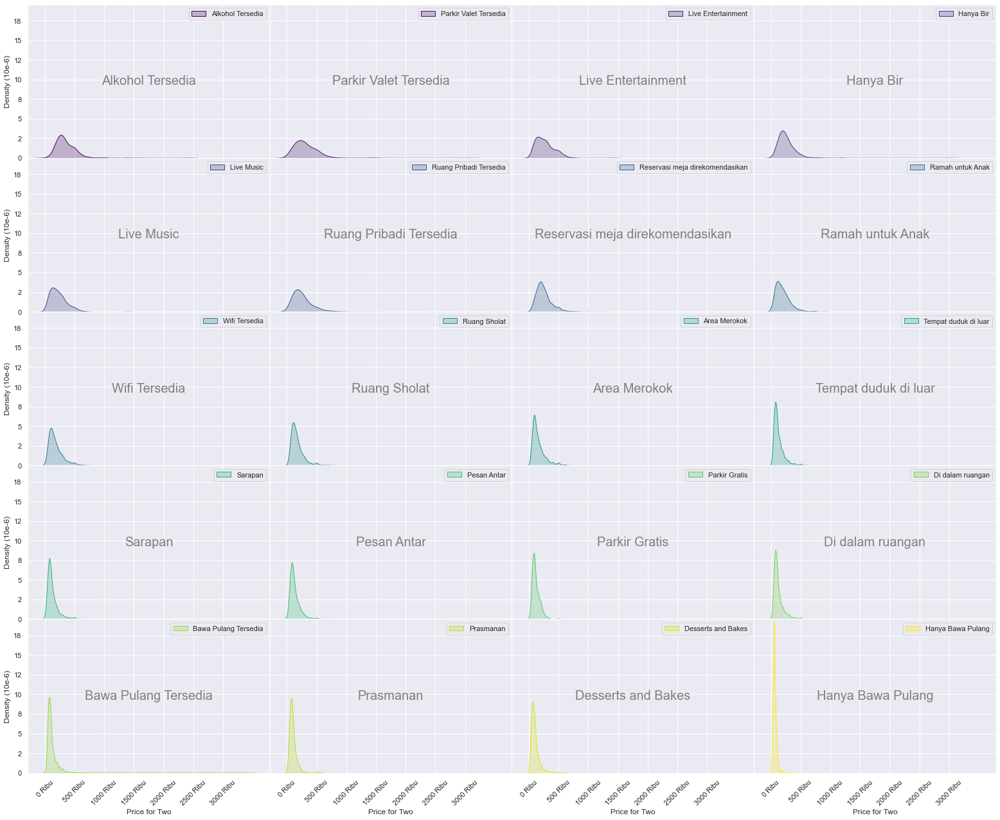

In [260]:
fig, ax = plt.subplots(5, 4, figsize=(27, 22), sharex=True, sharey=True)
plt.subplots_adjust(hspace=0, wspace=0)
ax = ax.flatten()

for idx, feat in enumerate(order_by_median):
    sub_data = data[data.features == feat]
    g = sns.kdeplot(data=sub_data, x='price_for_two', shade=True, color=viridis(idx/20), ax=ax[idx], label=feat)
    
    g.text(x=0.5, y=0.5, s=feat, color='gray', transform=ax[idx].transAxes, ha='center', va='center', fontsize=20)
    
    g.legend()
    g.set_xticklabels(labels=g.get_xticklabels(), rotation=45)
    
    ticks_loc = g.get_xticks().tolist()
    g.xaxis.set_major_locator(matplotlib.ticker.FixedLocator(ticks_loc))
    g.xaxis.set_major_formatter(lambda x, pos: f'{x/10**3:.0f} Ribu')
    g.yaxis.set_major_formatter(lambda x, pos: f'{x/10**-6:.0f}')
    
    g.set_ylabel('Density (10e-6)')
    g.set_xlabel('Price for Two')
    
    g.margins(0.02)

## Rating and Category

In [280]:
data.category.value_counts()[data.category.value_counts() != 1]

Quick Bites             6029
Restoran Kasual         2291
Kafe                    1917
Pujasera                1643
Toko Minuman            1151
Toko Kue & Roti          441
Toko Dessert             270
Kaki Lima                255
Kios                     228
Bar                      182
Lounge                   115
Restoran Fine Dining      58
Klub                      11
Kios Jus                   8
Pub                        4
Bar Wine                   3
Name: category, dtype: int64

In [284]:
data = df.dropna(subset=['rating']).copy()
data['category'] = data.category.str.split(', ')
data = data.explode('category')
top_cat = data.category.value_counts()[data.category.value_counts() != 1].index
order_by_median = data[data.category.isin(top_cat)].groupby('category')\
                    .agg(median=('rating', 'median')).sort_values('median', ascending=False).index

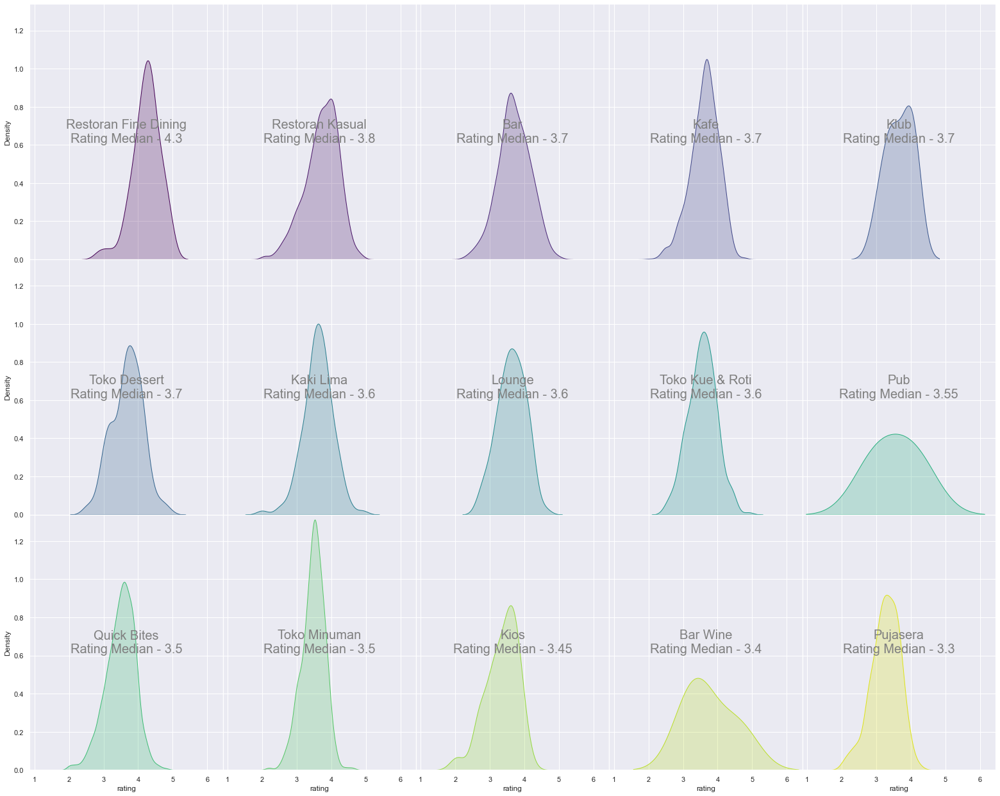

In [300]:
fig, ax = plt.subplots(3, 5, figsize=(27, 22), sharex=True, sharey=True)
plt.subplots_adjust(hspace=0, wspace=0)
ax = ax.flatten()

for idx, cat in enumerate(order_by_median):
    sub_data = data[data.category == cat]
    g = sns.kdeplot(data=sub_data, x='rating', shade=True, color=viridis(idx/15), ax=ax[idx], label=cat)
    
    g.text(x=0.5, y=0.5, s=f'{cat}\nRating Median - {sub_data.rating.median()}', color='gray', 
           transform=ax[idx].transAxes, ha='center', va='center', fontsize=20)

    g.margins(0.02)